---
format:
    html:
        toc: false
        page-layout: full
    execute:
        echo: false
---        

# MUSA550 Geospatial Data Science in Python
## Final Project
- Team: Hang Zhao, George Chen, Ling Chen

## Available Dataset & Sources

- [HK data gov](https://data.gov.hk/en/) Hong Kong Government Open Data
- [polyU sources](https://www.polyu.edu.hk/en/ubda/ubda-user/open-data-source-gov-hk/) Hong Kong PolyU open data sources
- [HK Observatory](https://www.hko.gov.hk/en/abouthko/opendata_intro.htm) Hong Kong Observatory
- [HK CSDI Portal](https://portal.csdi.gov.hk/csdi-webpage/) Hong Kong CSDI Spatial Data Portal
- [ESRI China](https://opendata.esrichina.hk/) ESRI China (Hong Kong) Geospatial Data

In [1]:
#| echo: true
#| code-fold: true

# The imports
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import requests
import geopandas as gpd
import hvplot.pandas
import rasterio as rio
import rioxarray
import xarray as xr
import hvplot.xarray
import panel as pn
import osmnx as ox
from shapely.geometry import Point
import seaborn as sns
import contextily as ctx

# Make sure plots show up in JupyterLab!
%matplotlib inline

In [2]:
pd.options.display.max_columns = 999

## Data Exploratory

### 1. Hong Kong Population

Areas with higher populations tend to experience a more pronounced UHI effect due to increased heat generation and retention associated with human activities and urban infrastructure. As such, we collect 2011/2016/2021 demographic data from Hong Kong Common Spatial Data Infrastructure Portal to see the distribution and trend of population. Specifically, we look into total population and average age in the exploratory analysis.

In [3]:
# url for population data
pop_url = (
    "https://services3.arcgis.com/6j1KwZfY2fZrfNMR/arcgis/rest/services/Hong_Kong_Population_Density_2021/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson"
)
pop_raw = gpd.read_file(pop_url)

In [4]:
pop_raw.head()

,OBJECTID,分區,District,人口密度,Population_Density,Shape__Area,Shape__Length,總人口,Total_population,geometry
0,1,黃大仙,Wong Tai Sin,43730,43730,1.092784e+07,17995.640782,406802,406802,"POLYGON ((114.17942 22.34905, 114.17946 22.349..."
1,2,九龍城,Kowloon City,40994,40994,1.184286e+07,31834.409404,410634,410634,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ..."
2,3,觀塘,Kwun Tong,59704,59704,1.322124e+07,25496.700164,673166,673166,"POLYGON ((114.24371 22.28620, 114.24370 22.286..."
3,4,西貢,Sai Kung,3771,3771,1.602944e+08,365545.476363,489037,489037,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ..."
4,5,北區,North,2269,2269,1.619184e+08,192815.532996,309631,309631,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ..."


In [5]:
district_url = (
    'https://services3.arcgis.com/6j1KwZfY2fZrfNMR/arcgis/rest/services/Hong_Kong_18_Districts/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson'
)
hk_limit = gpd.read_file(district_url)
hk_limit.head()

,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length,geometry
0,1,1,黃大仙區,黄大仙区,WONG TAI SIN,1.092784e+07,17995.640782,"POLYGON ((114.17942 22.34905, 114.17946 22.349..."
1,2,6,九龍城區,九龙城区,KOWLOON CITY,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ..."
2,3,7,觀塘區,观塘区,KWUN TONG,1.322124e+07,25496.700164,"POLYGON ((114.24371 22.28620, 114.24370 22.286..."
3,4,8,西貢區,西贡区,SAI KUNG,1.602944e+08,365545.476363,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ..."
4,5,11,北區,北区,NORTH,1.619184e+08,192815.532996,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ..."


In [6]:
pop_raw = pop_raw.drop(pop_raw.columns[[1, 3, 7]], axis=1)
pop_raw.head()

,OBJECTID,District,Population_Density,Shape__Area,Shape__Length,Total_population,geometry
0,1,Wong Tai Sin,43730,1.092784e+07,17995.640782,406802,"POLYGON ((114.17942 22.34905, 114.17946 22.349..."
1,2,Kowloon City,40994,1.184286e+07,31834.409404,410634,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ..."
2,3,Kwun Tong,59704,1.322124e+07,25496.700164,673166,"POLYGON ((114.24371 22.28620, 114.24370 22.286..."
3,4,Sai Kung,3771,1.602944e+08,365545.476363,489037,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ..."
4,5,North,2269,1.619184e+08,192815.532996,309631,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ..."


As seen in the map, the population is primarily concentrated in the central urban districts, which include Kwun Tong District, Yau Tsim Mong District, Kowloon City District, Wong Tai Sin District, Sham Shui Po District, and Eastern District across Victoria Harbour. The population density diminishes as the distance from the center increases.

In [7]:
pop_raw.hvplot(
    c="Population_Density",
    frame_width=600,
    frame_height=600, 
    alpha=0.7,
    geo=True,
    cmap="Oranges",
    hover_cols=["District"],
    tiles="CartoLight"
)

:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [Longitude,Latitude]   (Population_Density,District)

In [8]:
pop21_url=("https://services3.arcgis.com/6j1KwZfY2fZrfNMR/arcgis/rest/services/DCCA_21C/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson")
pop21_raw=gpd.read_file(pop21_url)
# The API endpoint
pop16_endpoint = "https://api.csdi.gov.hk/apim/dataquery/api/"

# The query parameters
pop16_params = {
    "id": "censtatd_rcd_1629267205219_53611",
    "layer":"dcca_16bc",
    "offset": "0",
    "limit":"452"
}
response = requests.get(pop16_endpoint, params=pop16_params)
response

<Response [200]>

In [9]:
features_pop16 = response.json()
pop16 = gpd.GeoDataFrame.from_features(features_pop16, crs="EPSG:4326")
pop16_select=pop16[['geometry','dc_eng','dcca_eng','ca_eng','t_pop','t_ma']]
pop21_select=pop21_raw[['geometry','dc_eng','dcca_eng','ca_eng','t_pop','t_ma']]
pop16_21 = pop16_select.merge(
    pop21_select,
    on=['dcca_eng']
)
pop16_21.rename(columns={
    't_pop_x': 'total_pop_2016',
    't_ma_x': 'median_age_2016',
    't_pop_y': 'total_pop_2021',
    't_ma_y': 'median_age_2021'
}, inplace=True)

pop16_21 = pop16_21.drop(pop16_21.columns[[6,7,8]],axis=1)
# The API endpoint
pop11_endpoint = "https://api.csdi.gov.hk/apim/dataquery/api/"

# The query parameters
pop11_params = {
    "id": "censtatd_rcd_1629267205229_46115",
    "layer":"dcca_11c",
    "offset": "0",
    "limit":"452"
}
response = requests.get(pop11_endpoint, params=pop11_params)
response

<Response [200]>

In [10]:
features_pop11 = response.json()
pop11 = gpd.GeoDataFrame.from_features(features_pop11, crs="EPSG:4326")
pop11_select=pop11[['geometry','dc_eng','dcca_eng','ca_eng','t_pop','t_ma']]
pop11_16_21 = pop16_21.merge(
    pop11_select[['dcca_eng','t_pop','t_ma']],
    on=['dcca_eng']
)

pop11_16_21.rename(columns={
    't_pop': 'total_pop_2011',
    't_ma': 'median_age_2011',
    'geometry_x':'geometry'
}, inplace=True)

pop11_16_21_long= pd.melt(pop11_16_21, 
                  id_vars=['geometry', 'dc_eng_x', 'dcca_eng', 'ca_eng_x'],
                  value_vars=['total_pop_2016', 'median_age_2016', 'total_pop_2021', 'median_age_2021', 'total_pop_2011', 'median_age_2011'],
                  var_name='pop/income by year', 
                  value_name='value')
geo_pop = gpd.GeoDataFrame(pop11_16_21_long, geometry='geometry')
geo_pop['value'] = geo_pop['value'].astype(float)

We have developed an interactive dashboard that provides demographic data for the years 2011, 2016, and 2021, organized by District Council District. This dashboard offers a detailed breakdown of densely populated areas, with a particular focus on the central urban district. Interestingly, we can also identify numerous smaller districts with significant population clusters in the outskirts of Hong Kong. For average age distribution especially in recent years, they are more likely to cluster in the core areas, followed by the New Territories in the north.

In [42]:
choropleth = geo_pop.to_crs(epsg=2326).hvplot(
    c="value",
    frame_width=600,
    frame_height=600,
    groupby='pop/income by year',
    alpha=0.6,
    geo=True,
    crs=2326,
    cmap="BuPu",
    dynamic=False,
    tiles="CartoLight"
)

choropleth

:HoloMap   [pop/income by year]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [Longitude,Latitude]   (value)

In [12]:
pop11_16_21 = gpd.GeoDataFrame(pop11_16_21, geometry='geometry')
pop_18dis = gpd.sjoin(pop11_16_21, hk_limit, how='left')
pop_18dis.sample()

,geometry,dc_eng_x,dcca_eng,ca_eng_x,total_pop_2016,median_age_2016,total_pop_2021,median_age_2021,total_pop_2011,median_age_2011,index_right,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length
193,"MULTIPOLYGON (((114.12785 22.35163, 114.12745 ...",Kwai Tsing,Kwai Tsing - Lai King,Lai King,13985,49.1,13658,53.4,14768,46.3,12,13,4,深水埗區,深水埗区,SHAM SHUI PO,1.100815e+07,28395.306312


In [13]:
agg_functions = {
    'total_pop_2016': 'sum',
    'total_pop_2021': 'sum',
    'total_pop_2011': 'sum',
    'median_age_2011': 'mean',  
    'median_age_2016': 'mean',
    'median_age_2021': 'mean'
}

pop_all = pop_18dis.groupby(['ENAME']).agg(agg_functions).reset_index()

### 2. Road Network

Urban Heat Island is related with transportation infrastructure as well, especially in densely populated cities like Hong Kong. As such, we further explore the this factor in the perspective of road network. Specifically, we'll further investigate into road length and road density within 18 districts in Hong Kong.

#### Retrieve Road Network from Open Street Map

As we can see from the exploratory map, the form and density of Hong Kong's road network are highly influenced by its hilly and mountainous terrain, resulting in a dispersed, complex, and high-density configuration. Hong Kong has a relatively well-developed road transportation network, but due to the presence of extensive urban development and roads, urban areas are prone to absorbing and storing heat, leading to relatively higher temperatures within the city.

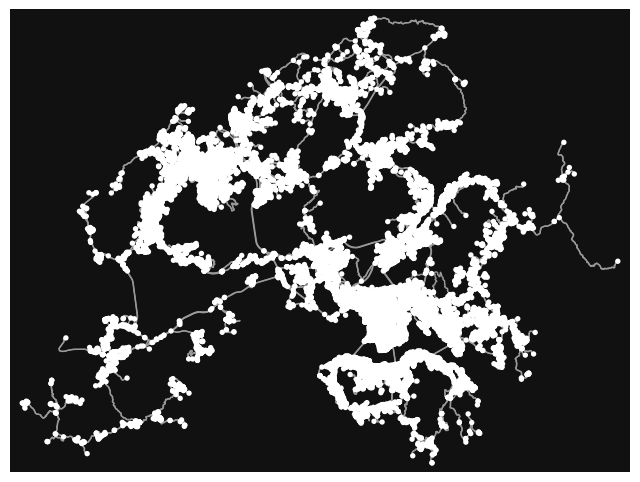

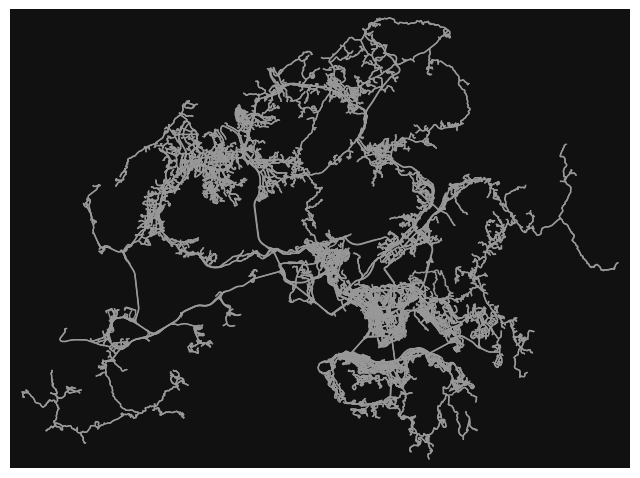

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [30]:
place_name = "Hong Kong"

G2 = ox.graph_from_place(place_name, network_type='drive')
ox.plot_graph(G2)
ox.plot_graph(ox.project_graph(G2), node_size=0)

In [31]:
road_edges = ox.graph_to_gdfs(G2, edges=True, nodes=False)

<Axes: >

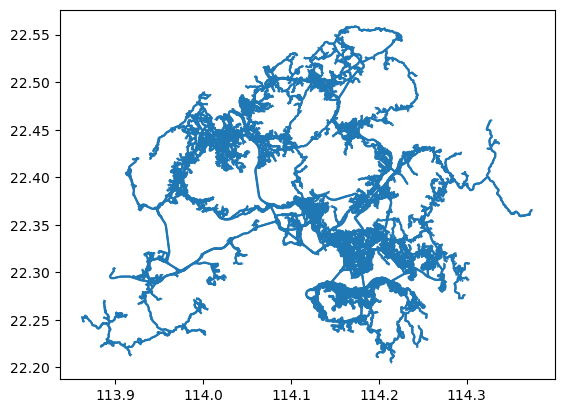

In [32]:
road_edges.plot()

#### Calculate Road Length & Density in 18 Districts

In [33]:
boundary_with_roads = gpd.sjoin(hk_limit, road_edges, op='intersects')
road_length = boundary_with_roads.groupby('ENAME')['length'].sum().reset_index()
road_length.head()

C:\Users\wawdj\mambaforge\envs\musa-550-fall-2023\lib\site-packages\IPython\core\interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,ENAME,length
0,CENTRAL & WESTERN,184421.695
1,EASTERN,196191.617
2,ISLANDS,347799.377
3,KOWLOON CITY,200720.061
4,KWAI TSING,325607.738


In [34]:
hk_limit['road_length'] = hk_limit['ENAME'].map(road_length.set_index('ENAME')['length'])
hk_limit.head()

,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length,geometry,road_length
0,1,1,黃大仙區,黄大仙区,WONG TAI SIN,1.092784e+07,17995.640782,"POLYGON ((114.17942 22.34905, 114.17946 22.349...",115676.019
1,2,6,九龍城區,九龙城区,KOWLOON CITY,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ...",200720.061
2,3,7,觀塘區,观塘区,KWUN TONG,1.322124e+07,25496.700164,"POLYGON ((114.24371 22.28620, 114.24370 22.286...",230842.202
3,4,8,西貢區,西贡区,SAI KUNG,1.602944e+08,365545.476363,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ...",380513.770
4,5,11,北區,北区,NORTH,1.619184e+08,192815.532996,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ...",435564.873


In [35]:
hk_limit['area'] = hk_limit['geometry'].area / 1e6  

hk_limit['road_density'] = hk_limit['road_length'] / hk_limit['area']

hk_limit.head()

C:\Users\wawdj\AppData\Local\Temp\ipykernel_2392\625515033.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  hk_limit['area'] = hk_limit['geometry'].area / 1e6


,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length,geometry,road_length,area,road_density
0,1,1,黃大仙區,黄大仙区,WONG TAI SIN,1.092784e+07,17995.640782,"POLYGON ((114.17942 22.34905, 114.17946 22.349...",115676.019,8.156332e-10,1.418236e+14
1,2,6,九龍城區,九龙城区,KOWLOON CITY,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ...",200720.061,9.172815e-10,2.188206e+14
2,3,7,觀塘區,观塘区,KWUN TONG,1.322124e+07,25496.700164,"POLYGON ((114.24371 22.28620, 114.24370 22.286...",230842.202,9.870107e-10,2.338801e+14
3,4,8,西貢區,西贡区,SAI KUNG,1.602944e+08,365545.476363,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ...",380513.770,1.196284e-08,3.180799e+13
4,5,11,北區,北区,NORTH,1.619184e+08,192815.532996,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ...",435564.873,1.207042e-08,3.608532e+13


It appears that the highest road network density is concentrated in the central and most urbanized districts of Hong Kong, such as Yau Tsim Mong, Kowloon City, and Sham Shui Po districts. Notably, Yuen Long District in the north stands as an exception, displaying relatively robust road network density. Conversely, as one moves farther away from the core districts, particularly towards the coastline, there is a gradual decline in road network density. The areas characterized by the lowest densities and minimal road infrastructure tend to be situated in remote or rural locations. Additionally, these areas may encompass the outlying islands or protected regions within the New Territories.

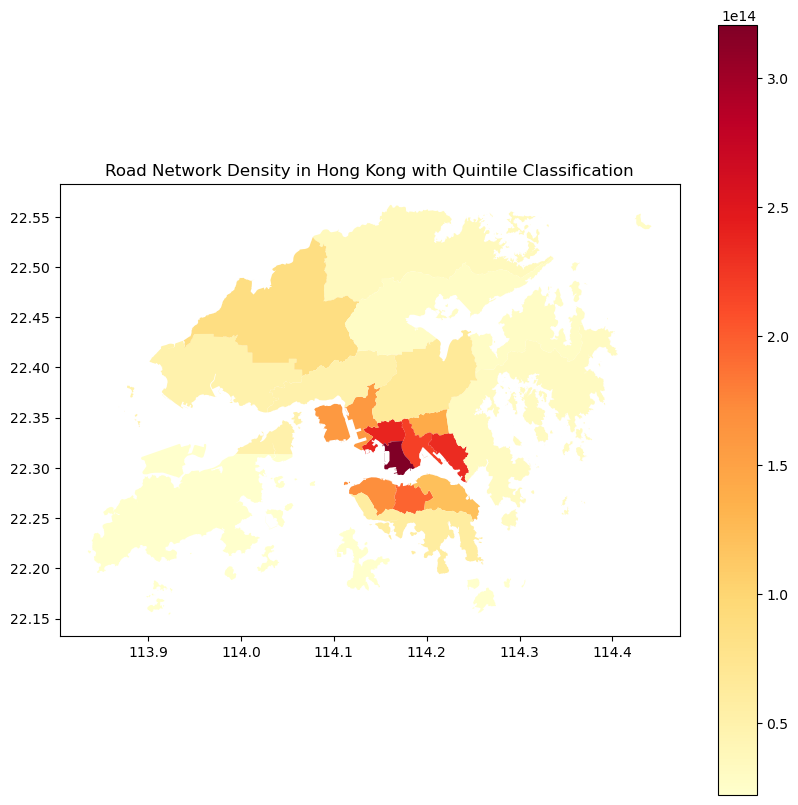

In [36]:
# Calculate quintiles for the 'road_density' column
quintiles = pd.qcut(hk_limit['road_density'], q=5)

f, ax = plt.subplots(1, figsize=(10, 10))
hk_limit.plot(column='road_density', classification_kwds={'bins':quintiles}, 
         cmap='YlOrRd', legend=True, ax=ax)

ax.set_title('Road Network Density in Hong Kong with Quintile Classification')
plt.show()

### 3. Land Use/ Zoning

Land use/ zoning also has a significant impact on the Urban Heat Island as well, as different types of land use can either mitigate or exacerbate the heat. In the context of Hong Kong, it boosts a wide range of open space like the green belt, agriculture, recreation areas, country parks, etc, which can mitigate the heat significance. Conversely, areas with intensive human activities and built environments tend to experience higher temperatures.

In [43]:
merged_df = pop_all.merge(hk_limit, on="ENAME", how='inner')
merged_df = gpd.GeoDataFrame(merged_df, geometry='geometry')

In [37]:
zoning2 = gpd.read_file("Data/Hong_Kong_Outline_Zoning_Plans_Land_Use_Zonings_.geojson")
zoning_select = zoning2[~zoning2['DESC_ENG'].str.contains(
    'Road|Village|Commercial|Government|Residential|Nullah|Industrial|Comprehensive|Railway|Authority|Development|Undetermined')]

In [38]:
fields_to_replace = ['Open Space', 'Green Belt', 'Conservation Area','Recreation',
                     'Site of Special Scientific Interest','Coastal Protection Area',
                     'Agriculture','Other Specified Uses','Pedestrian Street','Open Storage']

for field in fields_to_replace:
    zoning_select.loc[zoning_select['DESC_ENG'].str.contains(field), 'DESC_ENG'] = field

#### Filter Open Space Part within Land Use/Zoning

Within the zoning map, we have identified and selected land types with the potential to mitigate the influence of the Urban Heat Island. These include areas designated as open space, green belts, conservation areas, recreational sites, agricultural land, pedestrian streets, and coastal protection areas. These selected zones will be plotted to highlight their distribution and potential cooling effect on the urban environment.

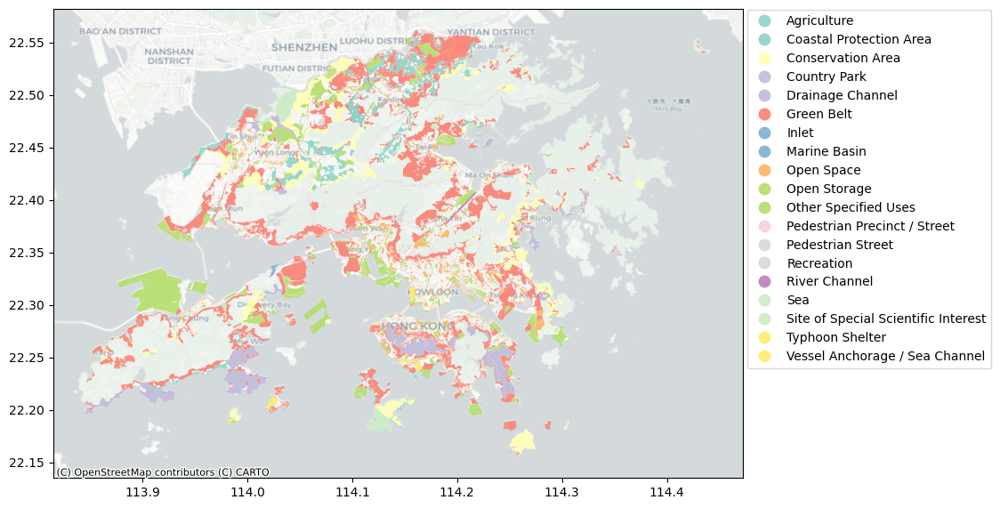

In [39]:
ax = zoning_select.plot(figsize=(10, 10), column='DESC_ENG', legend=True, cmap='Set3',alpha=0.9)
ctx.add_basemap(ax, crs=zoning_select.crs.to_string(), source=ctx.providers.CartoDB.Positron)

# Adjust the legend position
leg = ax.get_legend()
leg.set_bbox_to_anchor((1.37, 1.01))
#leg.set_location('center left')

plt.show()

In [44]:
zoning_select['center']=zoning_select.geometry.centroid

openspace = gpd.sjoin(merged_df, zoning_select, op='intersects')
openspace.head()

C:\Users\wawdj\AppData\Local\Temp\ipykernel_2392\516839381.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  zoning_select['center']=zoning_select.geometry.centroid
C:\Users\wawdj\mambaforge\envs\musa-550-fall-2023\lib\site-packages\geopandas\geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\wawdj\mambaforge\envs\musa-550-fall-2023\lib\site-packages\IPython\core\interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(cod

,ENAME,total_pop_2016,total_pop_2021,total_pop_2011,median_age_2011,median_age_2016,median_age_2021,OBJECTID_left,ID,CNAME,CNAME_S,Shape__Area_left,Shape__Length_left,geometry,road_length,area,road_density,index_right,OBJECTID_right,PLAN_NO,ZONE_LABEL,DESC_ENG,DESC_CHT,SPUSE_ENG,SPUSE_CHT,SHAPE_Leng,Shape__Area_right,Shape__Length_right,center
0,CENTRAL & WESTERN,340334,326280,346841,42.238095,44.076190,45.547619,6,13,中西區,中西区,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",184421.695,1.090622e-09,1.690977e+14,2673,2674,S/H10/20,GB,Green Belt,綠化地帶,,,6581.348959,619008.682861,6581.349029,POINT (114.14239 22.25675)
10,SOUTHERN,355603,339536,355804,43.250000,44.545455,48.404545,11,16,南區,南区,4.644934e+07,112548.313475,"MULTIPOLYGON (((114.11777 22.27384, 114.11853 ...",210406.422,3.469477e-09,6.064499e+13,2673,2674,S/H10/20,GB,Green Belt,綠化地帶,,,6581.348959,619008.682861,6581.349029,POINT (114.14239 22.25675)
0,CENTRAL & WESTERN,340334,326280,346841,42.238095,44.076190,45.547619,6,13,中西區,中西区,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",184421.695,1.090622e-09,1.690977e+14,899,900,S/H1/22,OU,Other Specified Uses,其他指定用途,PUBLIC MORTUARY,公眾殮房,233.257105,2865.110779,233.257108,POINT (114.11725 22.27801)
0,CENTRAL & WESTERN,340334,326280,346841,42.238095,44.076190,45.547619,6,13,中西區,中西区,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",184421.695,1.090622e-09,1.690977e+14,2758,2759,S/H10/20,CP,Country Park,郊野公園,,,1701.978533,97797.222290,1701.978533,POINT (114.14161 22.26246)
10,SOUTHERN,355603,339536,355804,43.250000,44.545455,48.404545,11,16,南區,南区,4.644934e+07,112548.313475,"MULTIPOLYGON (((114.11777 22.27384, 114.11853 ...",210406.422,3.469477e-09,6.064499e+13,2758,2759,S/H10/20,CP,Country Park,郊野公園,,,1701.978533,97797.222290,1701.978533,POINT (114.14161 22.26246)


In [45]:
open_area = openspace.groupby('ENAME')['Shape__Area_right'].sum().reset_index()
open_area['Shape__Area_right']=open_area['Shape__Area_right'] / 1e6 
open_area.head(18)

,ENAME,Shape__Area_right
0,CENTRAL & WESTERN,12.511457
1,EASTERN,15.717715
2,ISLANDS,93.395277
3,KOWLOON CITY,4.043059
4,KWAI TSING,16.084105
5,KWUN TONG,8.248983
6,NORTH,72.372960
7,SAI KUNG,38.122037
8,SHA TIN,25.508923
9,SHAM SHUI PO,6.539740


In [46]:
open_area = openspace.groupby('ENAME')['Shape__Area_right'].sum().reset_index()
open_area['Shape__Area_right']=open_area['Shape__Area_right'] / 1e6 

In [47]:
merged_df = merged_df.merge(open_area, on='ENAME', how='inner')

In [48]:
merged_df.head()

,ENAME,total_pop_2016,total_pop_2021,total_pop_2011,median_age_2011,median_age_2016,median_age_2021,OBJECTID,ID,CNAME,CNAME_S,Shape__Area,Shape__Length,geometry,road_length,area,road_density,Shape__Area_right
0,CENTRAL & WESTERN,340334,326280,346841,42.238095,44.076190,45.547619,6,13,中西區,中西区,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",184421.695,1.090622e-09,1.690977e+14,12.511457
1,EASTERN,627887,598232,632158,43.977500,44.047500,48.742500,8,15,東區,东区,2.184211e+07,36188.456666,"POLYGON ((114.24738 22.25339, 114.24733 22.253...",196191.617,1.631095e-09,1.202822e+14,15.717715
2,ISLANDS,106179,105513,87160,39.280000,42.060000,42.640000,12,2,離島區,离岛区,2.092858e+08,352295.332949,"MULTIPOLYGON (((113.92250 22.15339, 113.92241 ...",347799.377,1.563092e-08,2.225073e+13,93.395277
3,KOWLOON CITY,619041,599881,609338,43.321622,44.024324,46.962162,2,6,九龍城區,九龙城区,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ...",200720.061,9.172815e-10,2.188206e+14,4.043059
4,KWAI TSING,619133,576820,638052,42.177778,44.091667,48.169444,15,3,葵青區,葵青区,2.741789e+07,56502.167657,"MULTIPOLYGON (((114.09501 22.32524, 114.09501 ...",325607.738,2.046340e-09,1.591171e+14,16.084105


In [49]:
merged_df_long= pd.melt(merged_df, 
                  id_vars=['geometry', 'ENAME', 'OBJECTID','ID','CNAME','CNAME_S'],
                  value_vars=['total_pop_2016', 'median_age_2016', 'total_pop_2021', 'median_age_2021', 'total_pop_2011', 'median_age_2011','road_length','road_density','area'],
                  var_name='Variables', 
                  value_name='value')
geo_pop2 = gpd.GeoDataFrame(merged_df_long, geometry='geometry')
geo_pop2['value'] = geo_pop2['value'].astype(float)

In [50]:
choropleth2 = geo_pop2.to_crs(epsg=2326).hvplot(
    c="value",
    frame_width=600,
    frame_height=600,
    groupby='Variables',
    alpha=0.6,
    geo=True,
    crs=2326,
    cmap="BuPu",
    dynamic=False,
    tiles="CartoLight"
)

choropleth2


:HoloMap   [Variables]
   :Overlay
      .Tiles.I    :Tiles   [x,y]
      .Polygons.I :Polygons   [Longitude,Latitude]   (value)